# Run building detection inference with HIECTOR <img src="figs/hiector-logo.png" alt="hiector" width="300" align="right"/>

This notebook will guide you through the steps required to run large-scale inference of the hierarchical building detection models.

This notebook will use the city of Dakar, Senegal as area-of-interest (AOI). As the model is designed to work on large areas, it automatically deals with different UTM zones. The VHR imagery was made available through the [EDC Urban growth in Africa challenge](https://sinergise.com/en/news/join-urban-growth-africa-contest). 

The object detection uses the [_Single-Stage Rotation-Decoupled Detector for Oriented Object_](https://www.mdpi.com/2072-4292/12/19/3262/htm) architecture to estimate building footprints as oriented bounding boxes. The pre-trained models released have been trained on Sentinel-2, Airbus SPOT and Airbus Pleiades imagery.  

To execute this notebook you would need access to VHR imagery of your AOI and an account to Sentinel Hub service. Sentinel Hub service gives you access to entire Sentinel missions imaging archives and allows you to order, download and access Very High Resolution (VHR) satellite imagery such as Maxar WorldView, Airbus Pleiades and SPOT 6/7 and Planet PlanetScope over any AOI, only paying for what you need.

In addition, the original code uses [AWS](https://aws.amazon.com/) S3 buckets to store the data and AWS spot instances to run inference using [`ray`](https://www.ray.io/) to allow scaling to large areas. In this notebook we will use the local filesystem and run inference on the CPU, allowing execution on your laptop.

Table of contents:

 1. [Constants and utils](#1-constants-and-utils)
 2. [AOI splitting](#2-aoi-splitting)
 3. [Sentinel-2 data download and inference](#3-sentinel-2-data-download-and-inference)
 4. [Airbus SPOT data download and inference](#4-airbus-spot-data-download-and-inference)
 5. [Airbus Pleiades data download and inference](#5-airbus-pleiades-data-download-and-inference)
 6. [Joining Pleiades and SPOT predictions](#6-joining-pleiades-and-spot-predictions)

In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

In [2]:
import os
from collections import defaultdict
from functools import partial

import fs
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import shapely
from fs.osfs import OSFS
from tqdm.auto import tqdm

from eolearn.core import EOExecutor, EONode, EOWorkflow, LoadTask, OutputTask, OverwritePermission, SaveTask
from eolearn.core.utils.fs import get_aws_credentials
from hiector.tasks.execute import PredictEOPatch
from hiector.tasks.satellite_data import s2_data_input_task
from hiector.utils.aws_utils import LocalFile
from hiector.utils.download import get_download_workflow
from hiector.utils.geometry import close_holes, merge_predictions
from hiector.utils.grid import bboxes_to_wgs84, construct_eopatch_name, get_extent, merge_multiprocess, split_zone
from hiector.utils.metrics import convert_dota, iou_single
from hiector.utils.multiprocess import multiprocess
from sentinelhub import CRS, BBox, DataCollection, SHConfig, UtmGridSplitter

## 1 Constants and utils

This section sets up the constants used throughout the notebook, including credentials and collection IDs of the VHR data that you will order.

In [3]:
DAKAR_AOI_FILENAME = "input-data/dakar.geojson"
OUTPUT_DIR = "output-data"

# name of AWS S3 bucket where data will be stored, and corresponding profile where credentials are stored
AWS_S3_BUCKET_NAME = "<fill in>"
AWS_S3_PROFILE_NAME = "<fill in>"

# constants defining Sentinel-2 grid size, overlapping buffer and pixel size
S2_SIZE = 10000.0  # m
S2_BUFFER = 240.0  # m
S2_PIXEL_SIZE = 10.0  # m
S2_TIME_INTERVAL = ("2019-10-01", "2019-11-01")
S2_EOPATCHES_DIR = f"{OUTPUT_DIR}/s2-eopatches"
S2_INTERIOR_THR = 10000.0  # m2

# constants defining Airbus SPOT grid size, overlapping buffer and pixel size
SPOT_SIZE = 768.0  # m
SPOT_BUFFER = 36.0  # m
SPOT_PIXEL_SIZE = 1.5  # m
SPOT_SUB_GRID_SIZE = 80.0  # m
SPOT_EOPATCHES_DIR = f"{OUTPUT_DIR}/spot-eopatches/"
SPOT_TIME_INTERVAL = ("2019-01-01", "2019-12-31")
SPOT_COLLECTION_ID = "<fill-in>"

# constant defining the drill-down index
DRILL_DOWN_THR = 1.5

# constants defining Airbus SPOT grid size, overlapping buffer and pixel size
PLEIADES_SIZE = 768.0  # m
PLEIADES_BUFFER = 36.0  # m
PLEIADES_PIXEL_SIZE = 0.5  # m
PLEIADES_EOPATCHES_DIR = f"{OUTPUT_DIR}/pleiades-eopatches/"
PLEIADES_TIME_INTERVAL = ("2019-11-01", "2019-12-31")
PLEIADES_COLLECTION_ID = "<fill-in>"

Set the filesystem, local or AWS S3 bucket

In [4]:
# if you load/save to AWS S3 bucket
# filesystem = get_filesystem(AWS_S3_BUCKET_NAME, AWS_S3_PROFILE_NAME)

# if you load/save locally
filesystem = OSFS("/")

In [5]:
# set-up credentials for Sentinel Hub and AWS
sh_config = SHConfig()
sh_config.sh_client_id = "<fill-in>"
sh_config.sh_client_secret = "<fill-in>"
sh_config = get_aws_credentials(aws_profile=AWS_S3_PROFILE_NAME, config=sh_config)

Utility functions.

In [6]:
def prepare_grid(aoi, crs, size, buffer):
    """Split AOI into smaller bounding boxes and return as GeoDataFrame"""
    gdf = split_zone(aoi.iloc[0].geometry, crs, size, buffer)
    gdf["eopatch"] = gdf.apply(lambda x: construct_eopatch_name(x.geometry), axis=1)
    gdf["eopatch"] = gdf.apply(lambda r: f"{r.eopatch}-utm{r.bbox_crs.split(':')[-1]}", axis=1)
    gdf["bbox"] = gdf.geometry.apply(lambda g: g.wkt)
    gdf = bboxes_to_wgs84(gdf)
    return gdf


def save_dota_to_gpkg(eop_dota, dota_dir, eops_dir, filesystem, resolution, out_folder):
    """Convert the file with predictions in DOTA format to polygons in a geopackage file"""
    df = convert_dota(dota_dir, eops_dir, eop_dota, filesystem, resolution)
    eopname = eop_dota.split("_")[2][:-4]
    for utm in df:
        filepath = os.path.join(out_folder, f"{eopname}_{utm}.gpkg")
        with LocalFile(filepath, mode="w", filesystem=filesystem) as outf:
            df[utm].to_file(outf.path, driver="GPKG")


def load_gpkg(gpkg, filesystem):
    """Load geopackage and return content and utm"""
    basename = os.path.splitext(os.path.basename(gpkg))[0]
    _, epsg = basename.split("_")
    try:
        with LocalFile(gpkg, filesystem=filesystem) as f:
            file = gpd.read_file(f.path)
            filesystem.remove(gpkg)
            return file, epsg
    except Exception as e:
        print(f"Something went wrong for {gpkg} with error {e}")
        return None, None

## 2 AOI splitting

In this section we will read the geometry defining our AOI (i.e. Dakar) and we will split it into smaller chunks to allow for parallelization of processing. Checkout our [area splitting documentation](https://sentinelhub-py.readthedocs.io/en/latest/examples/large_area_utilities.html) for more information about the process.

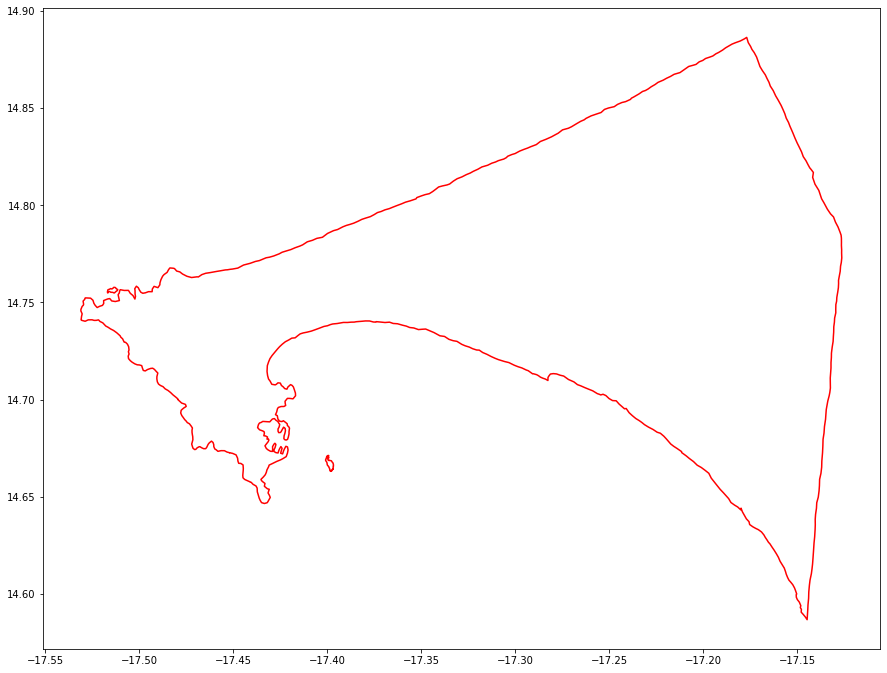

In [7]:
with LocalFile(DAKAR_AOI_FILENAME) as f:
    dakar_aoi = gpd.read_file(f.path)

fig, axs = plt.subplots(figsize=(15, 15))
dakar_aoi.boundary.plot(ax=axs, color="r")

There are two main ways to download Sentinel-2 imagery through Sentinel Hub, namely the [Process API](https://docs.sentinel-hub.com/api/latest/api/process/) or the [Batch Processing API](https://docs.sentinel-hub.com/api/latest/api/batch/). The latter is faster and cheaper compared to the former, but is available to enterprise users only. Get in touch if you wanted to gain access to it.

In this notebook we will split the AOIs manually and request data using the Process API through `eo-learn` tasks.

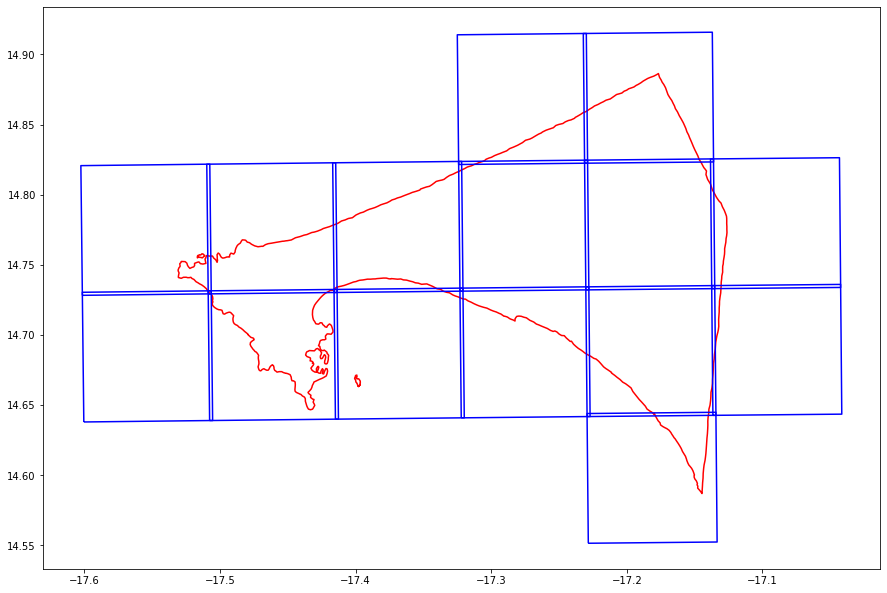

In [8]:
s2_grid = prepare_grid(dakar_aoi, CRS.WGS84, S2_SIZE, S2_BUFFER / S2_SIZE)

fig, axs = plt.subplots(figsize=(15, 15))
dakar_aoi.boundary.plot(ax=axs, color="r")
s2_grid.boundary.plot(ax=axs, color="b")

In [9]:
len(s2_grid)

15

In [10]:
s2_grid.head(5)

,geometry,bbox_crs,eopatch,bbox
0,"POLYGON ((-17.60048 14.63786, -17.60157 14.730...",EPSG:32628,eopatch-219880-1619880-utm32628,"POLYGON ((219880 1619880, 219880 1630120, 2301..."
1,"POLYGON ((-17.60154 14.72818, -17.60265 14.820...",EPSG:32628,eopatch-219880-1629880-utm32628,"POLYGON ((219880 1629880, 219880 1640120, 2301..."
2,"POLYGON ((-17.50771 14.63888, -17.50876 14.731...",EPSG:32628,eopatch-229880-1619880-utm32628,"POLYGON ((229880 1619880, 229880 1630120, 2401..."
3,"POLYGON ((-17.50874 14.72921, -17.50980 14.821...",EPSG:32628,eopatch-229880-1629880-utm32628,"POLYGON ((229880 1629880, 229880 1640120, 2401..."
4,"POLYGON ((-17.41493 14.63986, -17.41595 14.732...",EPSG:32628,eopatch-239880-1619880-utm32628,"POLYGON ((239880 1619880, 239880 1630120, 2501..."


## 3. Sentinel-2 data download and inference

We will now download data for each box defined above, and run inference. Splitting into smaller chunks allows to parallelize the operations.

All Sentinel-2 L1C bands are downloaded, although for inference we use only the bands at 10 m Ground Sample Distance.

In [11]:
input_task = s2_data_input_task(config=sh_config)

save_task = SaveTask(
    path=S2_EOPATCHES_DIR,
    overwrite_permission=OverwritePermission.OVERWRITE_PATCH,
    config=sh_config,
)

# this task is needed only to show the output of download
output_task = OutputTask()

We define a workflow with `eo-learn` to ease parallelization.

In [12]:
# Each EONode object defines dependencies to other EONode objects:
input_node = EONode(input_task, inputs=[], name="Download EOPatch")
save_node = EONode(save_task, inputs=[input_node], name="Save EOPatch")
output_node = EONode(output_task, inputs=[save_node], name="Output task")

workflow = EOWorkflow([input_node, save_node, output_node])

In [13]:
s2_grid["bbox"] = s2_grid.apply(lambda r: BBox(shapely.wkt.loads(r.bbox), crs=CRS(r.bbox_crs)), axis=1)

execution_args = [
    {
        input_node: {"bbox": eopatch.bbox, "time_interval": S2_TIME_INTERVAL},
        save_node: {"eopatch_folder": f"{eopatch.eopatch}"},
    }
    for eopatch in tqdm(s2_grid.itertuples(), total=len(s2_grid))
]

100%|██████████| 15/15 [00:00<00:00, 83551.87it/s]


For simplicity we run inference on a single Sentinel-2 grid bounding box.

In [14]:
# REMOVE THE INDEX ELEMENTS IN THE EXECUTION ARGUMENTS TO RUN ALL
executor = EOExecutor(workflow, execution_args[3:4], save_logs=True, logs_folder=".")
results = executor.run(workers=3)  # The execution will use at most 3 parallel processes

100%|██████████| 1/1 [00:14<00:00, 14.52s/it]


Bands are stored locally in an EOPatch.

In [15]:
eop = list(results[0].outputs.values())[0]
eop

EOPatch(
  data={
    BANDS: numpy.ndarray(shape=(1, 1024, 1024, 13), dtype=float32)
  }
  mask={
    CLM: numpy.ndarray(shape=(1, 1024, 1024, 1), dtype=uint8)
    dataMask: numpy.ndarray(shape=(1, 1024, 1024, 1), dtype=bool)
  }
  meta_info={
    maxcc: 0.2
    size_x: 1024
    size_y: 1024
    time_difference: 1.0
    time_interval: ('2019-10-01T00:00:00', '2019-11-01T23:59:59')
  }
  bbox=BBox(((229880.0, 1629880.0), (240120.0, 1640120.0)), crs=CRS('32628'))
  timestamp=[datetime.datetime(2019, 10, 1, 0, 0)]
)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


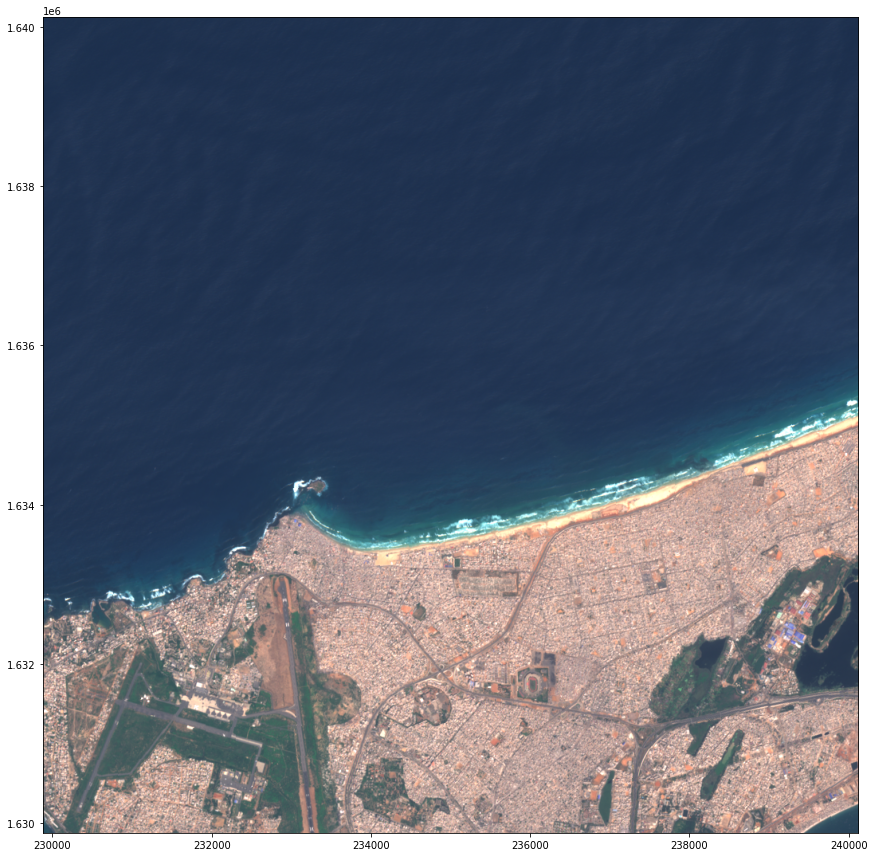

In [16]:
fig, axs = plt.subplots(figsize=(15, 15))
axs.imshow(3.5 * eop.data["BANDS"][0][..., [3, 2, 1]], extent=get_extent(eop))

### Copy Sentinel-2 pre-trained model and normalization factors locally

To run inference, we copy the pre-trained SSRDD model made publicly available on [the Query Planet AWS S3 bucket](s3://queryplanet.sentinel-hub.com/index.html).

This model was trained in Azerbaijan and not fine-tuned for Dakar.

In [17]:
!aws s3 ls s3://queryplanet.sentinel-hub.com/hiector/

                           PRE sentinel-2/
                           PRE spot-pleiades/
2022-03-16 22:30:10      16696 LICENSE
2022-03-18 00:27:19       1735 README
2022-03-16 22:41:11    2134016 buildings-dakar-2019.gpkg
2022-03-18 00:27:31     122880 label-aois-dakar-2019.gpkg


In [18]:
!aws s3 cp s3://queryplanet.sentinel-hub.com/hiector/sentinel-2/ ./sentinel-2/ --recursive

download: s3://queryplanet.sentinel-hub.com/hiector/sentinel-2/normalization-factors-sentinel-2.csv to sentinel-2/normalization-factors-sentinel-2.csv
download: s3://queryplanet.sentinel-hub.com/hiector/sentinel-2/weight/30000.pth to sentinel-2/weight/30000.pth


### Set-up inference configuration and run

Once data has been downloaded, inference can be run in parallel for each EOPatch. The inference process split the eopatch into smaller image chips of different sizes, applying multi-scale inference. Predictions for each image chip are combined using Non-Max Suppression. 

In [19]:
s2_inference_config = {
    "datasources": {
        "evaluate": {
            "modality": "s2",
            "data_dir": f"{os.getcwd()}/sentinel-2/",  # change this to your local path
            "eopatches_dir": f"{os.getcwd()}/{S2_EOPATCHES_DIR}",
            "normalization": {
                "filename": "normalization-factors-sentinel-2.csv",
                "modality": "s2",
            },
            "resolution": 10,
        }
    },
    "gridding_config": {
        "bands_feature": "BANDS",
        "bands": [1, 2, 3, 7],
        "data_mask_feature": "dataMask",
        "cloud_mask_feature": "CLM",
        "no_data_value": 0,
        "reference_feature": "reference",
        "cropped_grid_feature": "PATCHLETS",
        "bbox_type": "obb",
        "resolution": 10,
        "scale_sizes": [128],  # [64, 128, 256],
        "valid_thr": 0.6,
        "overlap": 0.25,
    },
    "num_workers": 4,
    "grid_file": None,
    "aws_model_dir": f"{os.getcwd()}/sentinel-2/",  # change this to your local path
    "s3_bucket_name": None,  # change to AWS_S3_BUCKET_NAME
    "s3_profile_name": None,  # change to AWS_S3_PROFILE_NAME
    "aws_dota_dir": f"{os.getcwd()}/{OUTPUT_DIR}/S2-DOTA",
    "aws_gpkg_dir": f"{os.getcwd()}/{OUTPUT_DIR}/S2-GPKG",
    "image_size": 128,
    "batch_size": 8,
    "class_names": ["building"],
    "lr": 1e-3,
    "max_step": 30000,
    "save_interval": 250,
    "backbone": "resnet.resnet34",
    "prior_box": {
        "strides": [1, 2, 4, 8],
        "sizes": [5],
        "aspects": [1, 2, 4, 8],
        "scales": [1, 1.2599, 1.5874, 2],
    },
    "checkpoint": None,
    "old_version": False,
    "head_stride_1": 1,
    "head_stride_2": 1,
    "conf_thresh": 0.01,
    "conf_thresh_2": 0.05,
    "nms_thresh": 0.45,
    "extra": 0,
}

In [20]:
predict_eop_task = PredictEOPatch(s2_inference_config, on_the_fly=True)
predict_eop_node = EONode(task=predict_eop_task)

workflow = EOWorkflow(workflow_nodes=[predict_eop_node])
exec_args = [
    {predict_eop_node: dict(eopatch_name=eopatch.eopatch)} for eopatch in tqdm(s2_grid.itertuples(), total=len(s2_grid))
]

100%|██████████| 15/15 [00:00<00:00, 70690.52it/s]


NOTE: This can take a while on CPU. To run on GPU, add `.cuda()` in the `PredictEOPatch` task.

In [21]:
executor = EOExecutor(workflow, exec_args[3:4], save_logs=True, logs_folder=".")
results = executor.run()

  0%|          | 0/1 [00:00<?, ?it/s]/home/dperessutti/venvs/qp3/lib/python3.8/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
100%|██████████| 1/1 [43:30<00:00, 2610.23s/it]


Convert the predictions from [DOTA](https://captain-whu.github.io/DOTA/) format to geopackages.

In [22]:
dota_eopatches = s2_grid.eopatch.unique()
dota_filenames = [f"Task1_building_{x}.txt" for x in dota_eopatches]
gpkg_filenames = [f"{eop}_{crs.lower()}.gpkg" for eop, crs in s2_grid[["eopatch", "bbox_crs"]].drop_duplicates().values]

save_gpkg_func = partial(
    save_dota_to_gpkg,
    dota_dir=s2_inference_config["aws_dota_dir"],
    eops_dir=s2_inference_config["datasources"]["evaluate"]["eopatches_dir"],
    filesystem=filesystem,
    resolution=s2_inference_config["datasources"]["evaluate"]["resolution"],
    out_folder=s2_inference_config["aws_gpkg_dir"],
)

for dota_filename in dota_filenames[3:4]:  # remove indices to run on all
    save_gpkg_func(dota_filename)

/home/dperessutti/venvs/qp3/lib/python3.8/site-packages/geopandas/io/file.py:362: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  pd.Int64Index,


In [23]:
!ls {OUTPUT_DIR}/S2-DOTA/

Task1_building_eopatch-229880-1629880-utm32628.txt


In [24]:
!ls {OUTPUT_DIR}/S2-GPKG/

eopatch-229880-1629880-utm32628_epsg:32628.gpkg


Read in all geopackage files into a dictionary, where different UTM zones are stored as different keys.

In [25]:
modality = s2_inference_config["datasources"]["evaluate"]["modality"]

predictions_per_utm = defaultdict(list)

gpkgs = [fs.path.join(s2_inference_config["aws_gpkg_dir"], gpkg) for gpkg in gpkg_filenames]

results = [load_gpkg(gpkg_filename, filesystem) for gpkg_filename in gpkgs[3:4]]  # remove indices to run on all
for gpkg, epsg in results:
    if gpkg is not None:
        predictions_per_utm[epsg].append(gpkg)

When predictions over multiple EOPatches are considered, there is an overlap area of duplicated predictions. The following code removes such predictions.

In [26]:
with LocalFile(
    fs.path.join(s2_inference_config["aws_gpkg_dir"], f"predictions_merged_{modality}.gpkg"),
    mode="w",
    filesystem=filesystem,
) as f:
    for utm in predictions_per_utm:
        utm_predictions = pd.concat(predictions_per_utm[utm])
        merged = merge_multiprocess(
            utm_predictions,
            iou_single,
            sorting_col="pseudo_probability",
            max_workers=s2_inference_config["num_workers"],
        )
        merged.to_file(f.path, layer=utm, driver="GPKG")

100%|██████████| 5099/5099 [00:57<00:00, 88.17it/s] 
/home/dperessutti/venvs/qp3/lib/python3.8/site-packages/geopandas/io/file.py:362: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  pd.Int64Index,


Simplify geometries into single polygon and fill holes.

In [27]:
merged_poly = merge_predictions(merged)
merged_poly.geometry = merged_poly.geometry.apply(lambda x: close_holes(x, S2_INTERIOR_THR))

/home/dperessutti/Work/qp3/hiector/utils/geometry.py:81: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  predictions_exploded = predictions.dissolve(by="dissolve_col").explode()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


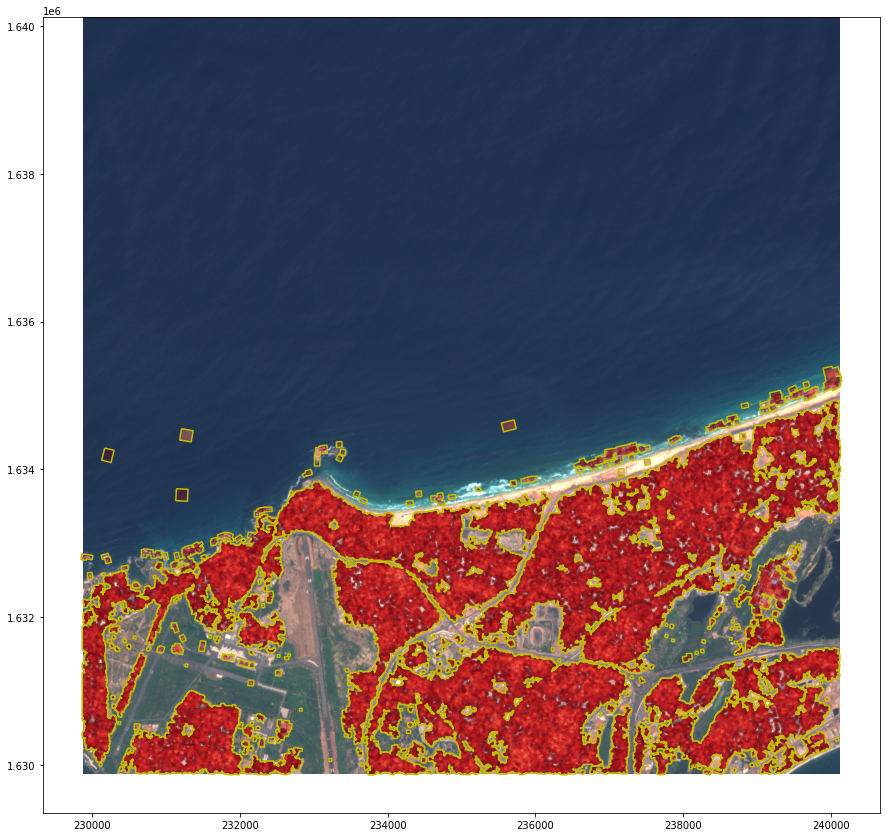

In [28]:
fig, axs = plt.subplots(figsize=(15, 15))
axs.imshow(3.5 * eop.data["BANDS"][0][..., [3, 2, 1]], extent=get_extent(eop))
merged.plot(ax=axs, column="pseudo_probability", alpha=0.4, cmap=plt.cm.Reds_r)
merged_poly.boundary.plot(ax=axs, color="y")

## 4. Airbus SPOT data download and inference

Now that we have identified areas of built-up, we can request higher resolution imagery to detect single buildings. In this example we will use Airbus SPOT imagery, which has a pixel size of 1.5 m for the pan-chromatic band, and 6 m for the four multi-spectral bands.

There are two choices:
 * requesting data for the exact multi-polygon predicted above;
 * split the predicted multi-polygon into bounding boxes and request data for each bounding box.

The first choice requests data exactly for the predicted area, with the risk of losing some built-up area. The second choice is more conservative but more expensive. We will do the second option as we have seen it still leads to large cost-savings for a negligible loss of built-up area.

The ordering of VHR imagery can be done programmatically through the [Third-Party Data Import API](https://docs.sentinel-hub.com/api/latest/api/data-import/), or manually using the [request builder](https://apps.sentinel-hub.com/requests-builder/) and applying the geometry of the data to be downloaded.

Once you order the data, you will get a collection ID and you can treat your data as any other data collection available through Sentinel Hub. Enter this collection in the constants section of this notebook and proceed.

In [29]:
spot_grid = prepare_grid(
    merged_poly.dissolve().to_crs(CRS.WGS84.pyproj_crs()),
    CRS.WGS84,
    SPOT_SIZE,
    SPOT_BUFFER / SPOT_SIZE,
)

To speed up the calculation, we show the rest of the processing for two EOPatches only, highlighted in yellow below.

In [30]:
spot_grid_small = spot_grid.iloc[[46, 53]]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


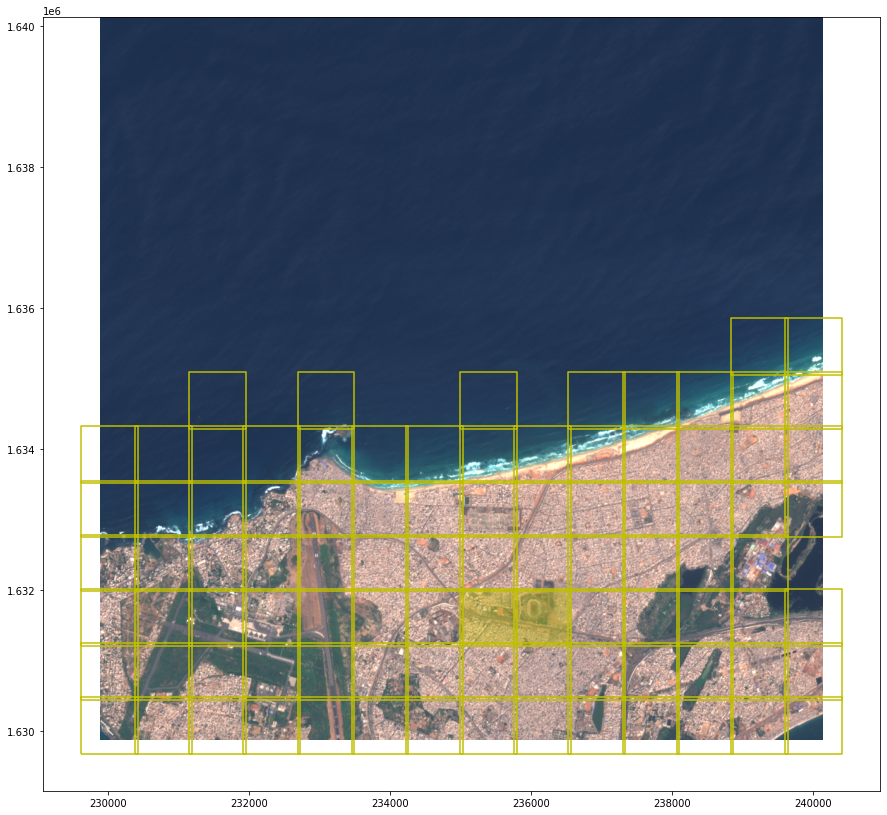

In [31]:
fig, axs = plt.subplots(figsize=(15, 15))
axs.imshow(3.5 * eop.data["BANDS"][0][..., [3, 2, 1]], extent=get_extent(eop))
spot_grid.to_crs(eop.bbox.crs.pyproj_crs()).boundary.plot(ax=axs, color="y")
spot_grid_small.to_crs(eop.bbox.crs.pyproj_crs()).plot(ax=axs, color="y", alpha=0.4)

In [32]:
spot_grid_small["bbox"] = spot_grid_small.apply(lambda r: BBox(shapely.wkt.loads(r.bbox), crs=CRS(r.bbox_crs)), axis=1)

/home/dperessutti/venvs/qp3/lib/python3.8/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [33]:
data_collection = DataCollection.define_byoc(SPOT_COLLECTION_ID)

The following evalscript allows us to define which data to request. In this case we will request pan-sharpened bands.

In [34]:
spot_evalscript = """
//VERSION=3

function setup() {
  return {
    input: ["B0", "B1", "B2", "B3", "PAN", "dataMask"],
    output: [{ id: "bands",
               bands: 4,
               sampleType: SampleType.FLOAT32},
             { id: "mask",
               bands: 1,
               sampleType: SampleType.UINT8}],
  }
}


function evaluatePixel(sample) {
    //Pansharpened bands from esri

    let weight = (sample.B0 * 0.24 + sample.B1 * 0.2 + sample.B2 * 0.24 + sample.B3 * 0)/ 0.68;

    if (weight == 0) {
     return {bands: [0, 0, 0, 0], mask: [sample.dataMask]};
    }

    let ratio = sample.PAN/weight;
    return {bands: [(sample.B0/10000)*ratio, (sample.B1/10000)*ratio, (sample.B2/10000)*ratio, (sample.B3/10000)*ratio],
            mask: [sample.dataMask]};
  }
"""

Although they are not needed for inference, we will add to the EOPatches the manual building footprints we have created and the polygons where these are defined. These data can be used for visual inspection of the results and to compute quantitative performance scores.

In [35]:
!aws s3 cp s3://queryplanet.sentinel-hub.com/hiector/buildings-dakar-2019.gpkg input-data/

download: s3://queryplanet.sentinel-hub.com/hiector/buildings-dakar-2019.gpkg to input-data/buildings-dakar-2019.gpkg


In [36]:
!aws s3 cp s3://queryplanet.sentinel-hub.com/hiector/label-aois-dakar-2019.gpkg input-data/

download: s3://queryplanet.sentinel-hub.com/hiector/label-aois-dakar-2019.gpkg to input-data/label-aois-dakar-2019.gpkg


Workflow to download the data.

In [37]:
workflow = get_download_workflow(
    data_collection,
    SPOT_PIXEL_SIZE,
    spot_evalscript,
    sh_config,
    ref_path="input-data/buildings-dakar-2019.gpkg",
    ml_aois_path="input-data/label-aois-dakar-2019.gpkg",
    save_path=SPOT_EOPATCHES_DIR,
)

In [38]:
nodes = workflow.get_nodes()

execution_args = [
    {
        nodes[0]: {"bbox": eopatch.bbox, "time_interval": SPOT_TIME_INTERVAL},
        nodes[-1]: {"eopatch_folder": f"{eopatch.eopatch}"},
    }
    for eopatch in tqdm(spot_grid_small.itertuples(), total=len(spot_grid_small))
]

100%|██████████| 2/2 [00:00<00:00, 12729.30it/s]


In [39]:
executor = EOExecutor(workflow, execution_args, save_logs=True, logs_folder=".")
results = executor.run(workers=3)  # The execution will use at most 3 parallel processes

  0%|          | 0/2 [00:00<?, ?it/s]/home/dperessutti/venvs/qp3/lib/python3.8/site-packages/geopandas/io/file.py:362: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  pd.Int64Index,
 50%|█████     | 1/2 [00:02<00:02,  2.84s/it]/home/dperessutti/venvs/qp3/lib/python3.8/site-packages/geopandas/io/file.py:362: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  pd.Int64Index,
100%|██████████| 2/2 [00:02<00:00,  1.46s/it]


Let's load the EOPatches from disk and check the downloaded images.

In [40]:
load_task = LoadTask(SPOT_EOPATCHES_DIR)

spot_eops = [load_task.execute(eopatch_folder=eopatch.eopatch) for eopatch in spot_grid_small.itertuples()]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


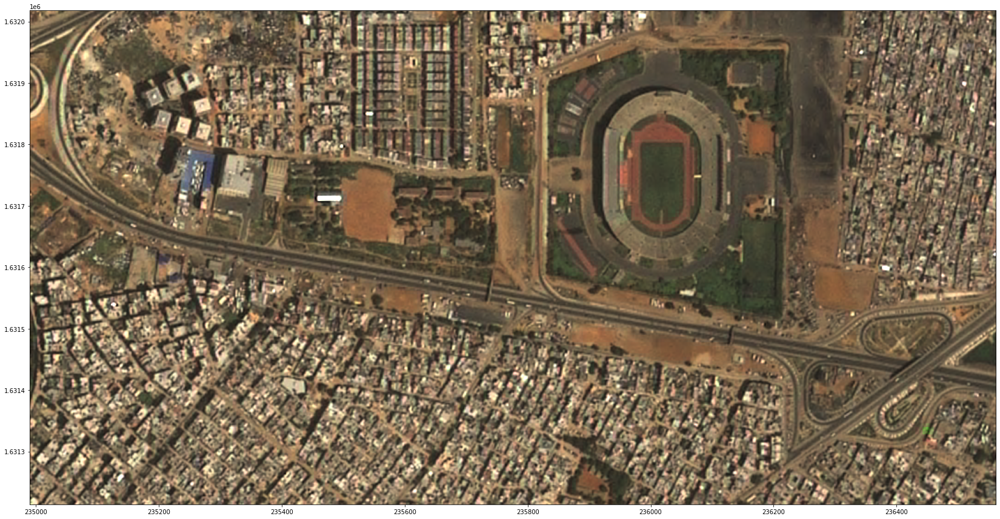

In [41]:
joint_img = np.concatenate(
    [
        spot_eops[0].data["bands"][0][:, :-12, [2, 1, 0]],
        spot_eops[1].data["bands"][0][:, 12:, [2, 1, 0]],
    ],
    axis=1,
)

extent = [
    get_extent(spot_eops[0])[0],
    get_extent(spot_eops[1])[1],
    *get_extent(spot_eops[0])[2:],
]

fig, axs = plt.subplots(figsize=(30, 15))
axs.imshow(2.5 * joint_img, extent=extent)

### Copy SPOT-Pleiades pre-trained model and normalization factors locally

Inference on SPOT and Pleiades imagery will be executed using a single model which was trained jointly on both data sources. The model was trained using data in Azerbaijan and fine-tuned for Dakar using a subset of the manually validated data publicly released. Since such data is very small, performance can be largely improved increasing the size of the training data.

In [42]:
!aws s3 cp s3://queryplanet.sentinel-hub.com/hiector/spot-pleiades/ ./spot-pleiades/ --recursive

download: s3://queryplanet.sentinel-hub.com/hiector/spot-pleiades/normalization-factors-pleiades.csv to spot-pleiades/normalization-factors-pleiades.csv
download: s3://queryplanet.sentinel-hub.com/hiector/spot-pleiades/normalization-factors-spot.csv to spot-pleiades/normalization-factors-spot.csv
download: s3://queryplanet.sentinel-hub.com/hiector/spot-pleiades/weight/40000.pth to spot-pleiades/weight/40000.pth


In [43]:
spot_inference_config = {
    "datasources": {
        "evaluate": {
            "modality": "spot",
            "data_dir": f"{os.getcwd()}/spot-pleiades/",  # change this to your local path
            "eopatches_dir": f"{os.getcwd()}/{SPOT_EOPATCHES_DIR}",
            "normalization": {
                "filename": "normalization-factors-spot.csv",
                "modality": "spot",
            },
            "resolution": 1.5,
        }
    },
    "gridding_config": {
        "bands_feature": "bands",
        "bands": [0, 1, 2, 3],
        "take_closest_time_frame": None,
        "data_mask_feature": "mask",
        "cloud_mask_feature": None,
        "no_data_value": 0,
        "reference_feature": "reference",
        "cropped_grid_feature": "PATCHLETS",
        "bbox_type": "obb",
        "resolution": 1.5,
        "scale_sizes": [64, 128, 256],
        "valid_thr": 0.6,
        "overlap": 0.25,
    },
    "num_workers": 4,
    "grid_file": None,
    "aws_model_dir": f"{os.getcwd()}/spot-pleiades/",  # change this to your local path
    "s3_bucket_name": None,  # change to AWS_S3_BUCKET_NAME
    "s3_profile_name": None,  # change to AWS_S3_PROFILE_NAME
    "aws_dota_dir": f"{os.getcwd()}/{OUTPUT_DIR}/SPOT-DOTA",
    "aws_gpkg_dir": f"{os.getcwd()}/{OUTPUT_DIR}/SPOT-GPKG",
    "image_size": 256,
    "batch_size": 8,
    "class_names": ["building"],
    "lr": 1e-3,
    "max_step": 40000,
    "save_interval": 250,
    "backbone": "resnet.resnet34",
    "prior_box": {
        "strides": [2, 4, 8, 16],
        "sizes": [7],
        "aspects": [1, 2, 4, 8, 16],
        "scales": [1, 1.2599, 1.5874, 2],
    },
    "checkpoint": None,
    "old_version": False,
    "head_stride_1": 1,
    "head_stride_2": 2,
    "conf_thresh": 0.01,
    "conf_thresh_2": 0.1,
    "nms_thresh": 0.2,
    "extra": 0,
}

In [44]:
predict_eop_task = PredictEOPatch(spot_inference_config, on_the_fly=True)
predict_eop_node = EONode(task=predict_eop_task)

workflow = EOWorkflow(workflow_nodes=[predict_eop_node])
exec_args = [
    {predict_eop_node: dict(eopatch_name=eopatch.eopatch)}
    for eopatch in tqdm(spot_grid_small.itertuples(), total=len(spot_grid_small))
]

100%|██████████| 2/2 [00:00<00:00, 7345.54it/s]


In [45]:
executor = EOExecutor(workflow, exec_args, save_logs=True, logs_folder=".")
results = executor.run()

100%|██████████| 2/2 [14:26<00:00, 433.41s/it]


Conversion from DOTA format to GPKG.

In [46]:
dota_eopatches = spot_grid_small.eopatch.unique()  # use spot_grid to run on all
dota_filenames = [f"Task1_building_{x}.txt" for x in dota_eopatches]
gpkg_filenames = [
    f"{eop}_{crs.lower()}.gpkg" for eop, crs in spot_grid_small[["eopatch", "bbox_crs"]].drop_duplicates().values
]

save_gpkg_func = partial(
    save_dota_to_gpkg,
    dota_dir=spot_inference_config["aws_dota_dir"],
    eops_dir=spot_inference_config["datasources"]["evaluate"]["eopatches_dir"],
    filesystem=filesystem,
    resolution=spot_inference_config["datasources"]["evaluate"]["resolution"],
    out_folder=spot_inference_config["aws_gpkg_dir"],
)

for dota_filename in dota_filenames:
    save_gpkg_func(dota_filename)

/home/dperessutti/venvs/qp3/lib/python3.8/site-packages/geopandas/io/file.py:362: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  pd.Int64Index,
/home/dperessutti/venvs/qp3/lib/python3.8/site-packages/geopandas/io/file.py:362: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  pd.Int64Index,


Join separate predictions into a single dataframe and remove duplicate predictions over the overlapping areas.

In [47]:
modality = spot_inference_config["datasources"]["evaluate"]["modality"]

predictions_per_utm = defaultdict(list)

gpkgs = [fs.path.join(spot_inference_config["aws_gpkg_dir"], gpkg) for gpkg in gpkg_filenames]

results = [load_gpkg(gpkg_filename, filesystem) for gpkg_filename in gpkgs]
for gpkg, epsg in results:
    if gpkg is not None:
        predictions_per_utm[epsg].append(gpkg)

In [48]:
with LocalFile(
    fs.path.join(spot_inference_config["aws_gpkg_dir"], f"predictions_merged_{modality}.gpkg"),
    mode="w",
    filesystem=filesystem,
) as f:
    for utm in predictions_per_utm:
        utm_predictions = pd.concat(predictions_per_utm[utm])
        merged = merge_multiprocess(
            utm_predictions,
            iou_single,
            sorting_col="pseudo_probability",
            max_workers=spot_inference_config["num_workers"],
        )
        merged.to_file(f.path, layer=utm, driver="GPKG")

100%|██████████| 3181/3181 [00:06<00:00, 507.07it/s]
/home/dperessutti/venvs/qp3/lib/python3.8/site-packages/geopandas/io/file.py:362: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  pd.Int64Index,


Let's visualise the detected buildings.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


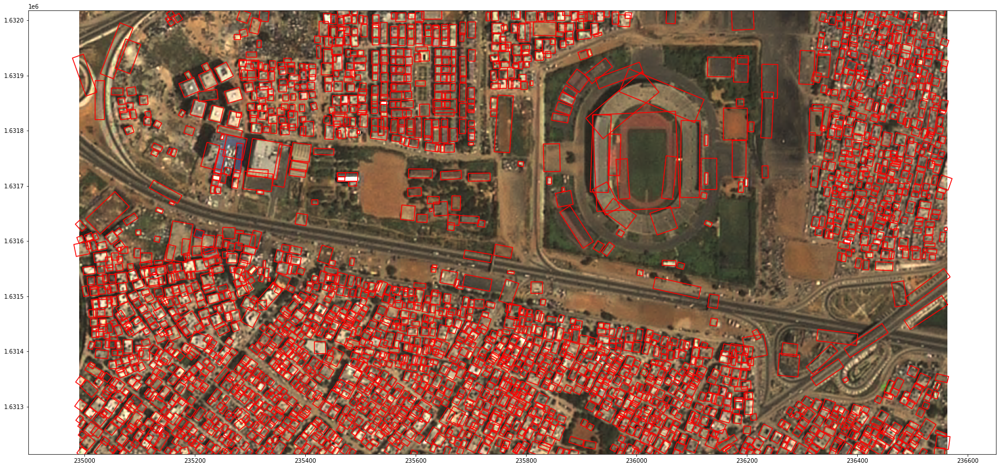

In [49]:
fig, axs = plt.subplots(figsize=(30, 15))
axs.imshow(2.5 * joint_img, extent=extent)
merged.query("pseudo_probability >= 0.2").boundary.plot(ax=axs, color="r")

## 5. Airbus Pleiades data download and inference

Now that we have estimated buildings as oriented bounding boxes using Airbus SPOT imagery, we can proceed with the drill-down approach and identify areas where higher resolution imagery would be necessary to delineate more accurately the buildings.

The drill-down approach is as follows:
 * further split the area with SPOT predictions into a smaller sub-grid;
 * for each cell in the sub-grid compute statistics about the estimated buildings;
 * compute a drill-down index that is a function of how many buildings are in the cell and the confidence of their prediction;
 * order higher resolution imagery, i.e. Airbus Pleiades, only for the sub-cells with index higher than a threshold.

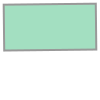

In [50]:
sub_grid_geom = spot_grid_small.to_crs(CRS.WGS84.pyproj_crs()).geometry.unary_union
sub_grid_geom

We further split the area below into a sub-grid where each cell as size `SPOT_SUB_GRID_SIZE`. Change this parameter according to your needs and data VHR sources used.

In [51]:
sub_grid_bboxes = UtmGridSplitter([sub_grid_geom], CRS.WGS84, bbox_size=SPOT_SUB_GRID_SIZE)

In [52]:
sub_grid_bbox_list = sub_grid_bboxes.get_bbox_list()

Let's compute statistics for the detected buildings.

In [53]:
def get_bbox_stats(bbox, predictions_file):
    """Compute statistics for each cell in the sub-grid"""
    gdf_ = gpd.read_file(predictions_file, bbox=bbox.geometry)
    return dict(
        geometry=bbox.geometry,
        n_buildings=len(gdf_),
        q10_building_size=gdf_.geometry.area.quantile(q=0.1),
        q90_building_size=gdf_.geometry.area.quantile(q=0.9),
        mean_building_size=gdf_.geometry.area.mean(),
        median_building_size=gdf_.geometry.area.median(),
        q10_pseudoproba=gdf_.pseudo_probability.quantile(q=0.1),
        q90_pseudoproba=gdf_.pseudo_probability.quantile(q=0.9),
        mean_pseudoproba=gdf_.pseudo_probability.mean(),
        median_pseudoproba=gdf_.pseudo_probability.median(),
    )

In [54]:
bbox_stats_func = partial(
    get_bbox_stats,
    predictions_file=fs.path.join(spot_inference_config["aws_gpkg_dir"], f"predictions_merged_{modality}.gpkg"),
)

In [55]:
results = multiprocess(
    bbox_stats_func,
    sub_grid_bbox_list,
    max_workers=spot_inference_config["num_workers"],
)

231it [00:00, 304.57it/s]


In [56]:
bbox_stats = gpd.GeoDataFrame(results)
bbox_stats.set_crs(epsg="32628", inplace=True);

In [57]:
bbox_stats.columns

Index(['geometry', 'n_buildings', 'q10_building_size', 'q90_building_size',
       'mean_building_size', 'median_building_size', 'q10_pseudoproba',
       'q90_pseudoproba', 'mean_pseudoproba', 'median_pseudoproba'],
      dtype='object')

In [58]:
bbox_stats = bbox_stats[~bbox_stats.mean_pseudoproba.isnull()]

Let's define a drill-down index, which aims at describing areas with many detections of low confidence. You can define this index as best suitable for your application.

In [59]:
bbox_stats["drill_index"] = np.log10(bbox_stats["n_buildings"]) * np.exp((1 - bbox_stats["mean_pseudoproba"]) ** 6)

The following figure shows that the `drill_index` is larger for densely populated areas, where higher resolution imagery should provide more accurate results. 

An empirical threshold of 1.5 is used to define areas where higher reolution imagery will be ordered and processed, delineated by cells with yellow boundary.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


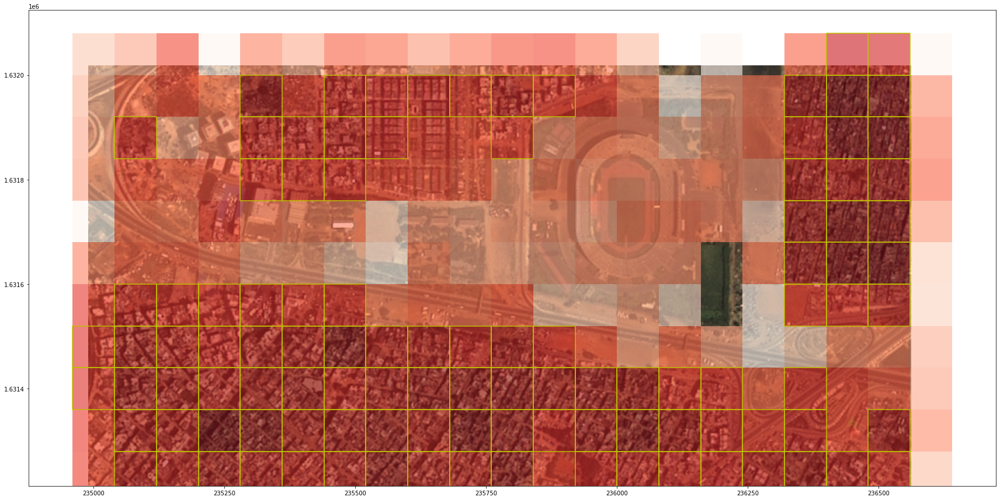

In [60]:
fig, axs = plt.subplots(figsize=(30, 15))
axs.imshow(2.5 * joint_img, extent=extent)
bbox_stats.plot(ax=axs, column="drill_index", cmap=plt.cm.Reds, alpha=0.6)
bbox_stats.query(f"drill_index >= {DRILL_DOWN_THR}").boundary.plot(ax=axs, color="y")

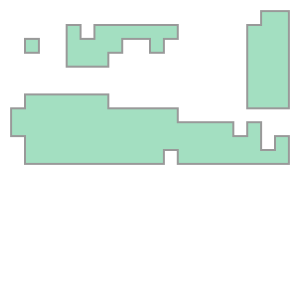

In [61]:
drill_geom = bbox_stats.query(f"drill_index >= {DRILL_DOWN_THR}").unary_union
drill_geom

We can now use the geometry above to order higher resolution imagery. Some providers hae a minimum order area limit, which would influence the size of the cells in the sub-grid. In some cases you can request multi-polygons of area larger than the minimum order size.

As for SPOT, once we order Airbus Pleiades, we will get a collection ID that we'll add to the notebook in the constants section.

In this example, we already have Pleiades imagery available for the entire AOI, therefore we will simulate the fact of not having data for the regions we are not interested in.

In [62]:
pleiades_grid_small = spot_grid_small

In [63]:
data_collection = DataCollection.define_byoc(PLEIADES_COLLECTION_ID)

Similarly to SPOT, pan-sharpened bands are downloaded from the Sentinel Hub service.

In [64]:
pleiades_evalscript = """
//VERSION=3
function setup() {
    return {
      input: ["B0", "B1", "B2", "B3", "PAN", "dataMask"],
      output: [{ id: "bands",
                 bands: 4 ,
                 sampleType: SampleType.FLOAT32},
               { id: "mask",
                 bands: 1,
                 sampleType: SampleType.UINT8}],
    };
  }

  function evaluatePixel(sample) {
    //Pansharpened bands from esri

    let weight = (sample.B0 * 0.34 + sample.B1 * 0.34 + sample.B2 * 0.2 + sample.B3 * 0.23)/ 1.11;

    if (weight == 0) {
     return {bands: [0, 0, 0, 0], mask: [sample.dataMask]};
    }

    let ratio = sample.PAN/weight;
    return {bands: [(sample.B0/10000)*ratio, (sample.B1/10000)*ratio, (sample.B2/10000)*ratio, (sample.B3/10000)*ratio],
            mask: [sample.dataMask]};
  }

"""

In [65]:
workflow = get_download_workflow(
    data_collection,
    PLEIADES_PIXEL_SIZE,
    pleiades_evalscript,
    sh_config,
    ref_path="input-data/buildings-dakar-2019.gpkg",
    ml_aois_path="input-data/label-aois-dakar-2019.gpkg",
    save_path=PLEIADES_EOPATCHES_DIR,
)

In [66]:
nodes = workflow.get_nodes()

execution_args = [
    {
        nodes[0]: {"bbox": eopatch.bbox, "time_interval": PLEIADES_TIME_INTERVAL},
        nodes[-1]: {"eopatch_folder": f"{eopatch.eopatch}"},
    }
    for eopatch in tqdm(pleiades_grid_small.itertuples(), total=len(pleiades_grid_small))
]

100%|██████████| 2/2 [00:00<00:00, 3338.09it/s]


In [67]:
executor = EOExecutor(workflow, execution_args, save_logs=True, logs_folder=".")
results = executor.run(workers=3)  # The execution will use at most 3 parallel processes

  0%|          | 0/2 [00:00<?, ?it/s]/home/dperessutti/venvs/qp3/lib/python3.8/site-packages/geopandas/io/file.py:362: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  pd.Int64Index,
 50%|█████     | 1/2 [00:11<00:11, 11.04s/it]/home/dperessutti/venvs/qp3/lib/python3.8/site-packages/geopandas/io/file.py:362: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  pd.Int64Index,
100%|██████████| 2/2 [00:14<00:00,  7.25s/it]


In [68]:
load_task = LoadTask(PLEIADES_EOPATCHES_DIR)

pleiades_eops = [load_task.execute(eopatch_folder=eopatch.eopatch) for eopatch in pleiades_grid_small.itertuples()]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


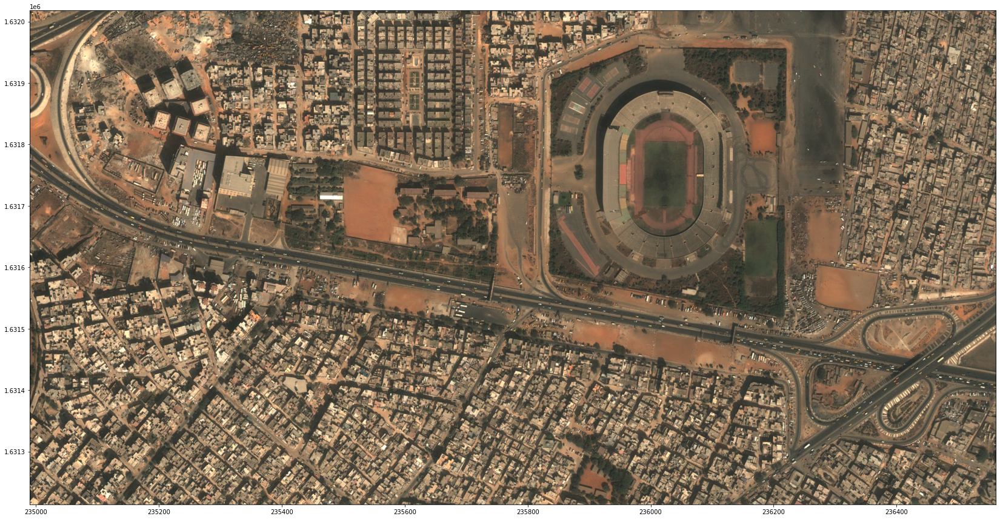

In [69]:
joint_img = np.concatenate(
    [
        pleiades_eops[0].data["bands"][0][:, :-36, [2, 1, 0]],
        pleiades_eops[1].data["bands"][0][:, 36:, [2, 1, 0]],
    ],
    axis=1,
)

extent = [
    get_extent(pleiades_eops[0])[0],
    get_extent(pleiades_eops[1])[1],
    *get_extent(pleiades_eops[0])[2:],
]

fig, axs = plt.subplots(figsize=(30, 15))
axs.imshow(2.5 * joint_img, extent=extent)

Let's run inference on the downloaded Pleiades images using the following configuration dictionary.

In [70]:
pleiades_inference_config = {
    "datasources": {
        "evaluate": {
            "modality": "pleiades",
            "data_dir": f"{os.getcwd()}/spot-pleiades/",  # change this to your local path
            "eopatches_dir": f"{os.getcwd()}/{PLEIADES_EOPATCHES_DIR}",
            "normalization": {
                "filename": "normalization-factors-pleiades.csv",
                "modality": "pleiades",
            },
            "resolution": 0.5,
        }
    },
    "gridding_config": {
        "bands_feature": "bands",
        "bands": [0, 1, 2, 3],
        "take_closest_time_frame": None,
        "data_mask_feature": "mask",
        "cloud_mask_feature": None,
        "no_data_value": 0,
        "reference_feature": "reference",
        "cropped_grid_feature": "PATCHLETS",
        "bbox_type": "obb",
        "resolution": 0.5,
        "scale_sizes": [128, 256, 512],
        "valid_thr": 0.6,
        "overlap": 0.25,
    },
    "num_workers": 4,
    "grid_file": None,
    "aws_model_dir": f"{os.getcwd()}/spot-pleiades/",  # change this to your local path
    "s3_bucket_name": None,  # change to AWS_S3_BUCKET_NAME
    "s3_profile_name": None,  # change to AWS_S3_PROFILE_NAME
    "aws_dota_dir": f"{os.getcwd()}/{OUTPUT_DIR}/PLEIADES-DOTA",
    "aws_gpkg_dir": f"{os.getcwd()}/{OUTPUT_DIR}/PLEIADES-GPKG",
    "image_size": 256,
    "batch_size": 8,
    "class_names": ["building"],
    "lr": 1e-3,
    "max_step": 40000,
    "save_interval": 250,
    "backbone": "resnet.resnet34",
    "prior_box": {
        "strides": [2, 4, 8, 16],
        "sizes": [7],
        "aspects": [1, 2, 4, 8, 16],
        "scales": [1, 1.2599, 1.5874, 2],
    },
    "checkpoint": None,
    "old_version": False,
    "head_stride_1": 1,
    "head_stride_2": 2,
    "conf_thresh": 0.01,
    "conf_thresh_2": 0.1,
    "nms_thresh": 0.2,
    "extra": 0,
}

In [71]:
predict_eop_task = PredictEOPatch(pleiades_inference_config, on_the_fly=True)
predict_eop_node = EONode(task=predict_eop_task)

workflow = EOWorkflow(workflow_nodes=[predict_eop_node])
exec_args = [
    {predict_eop_node: dict(eopatch_name=eopatch.eopatch)}
    for eopatch in tqdm(pleiades_grid_small.itertuples(), total=len(pleiades_grid_small))
]

100%|██████████| 2/2 [00:00<00:00, 9039.45it/s]


In [72]:
executor = EOExecutor(workflow, exec_args, save_logs=True, logs_folder=".")
results = executor.run()

100%|██████████| 2/2 [24:47<00:00, 743.59s/it]


Conversion from DOTA format to GPKG.

In [73]:
dota_eopatches = pleiades_grid_small.eopatch.unique()
dota_filenames = [f"Task1_building_{x}.txt" for x in dota_eopatches]
gpkg_filenames = [
    f"{eop}_{crs.lower()}.gpkg" for eop, crs in pleiades_grid_small[["eopatch", "bbox_crs"]].drop_duplicates().values
]

save_gpkg_func = partial(
    save_dota_to_gpkg,
    dota_dir=pleiades_inference_config["aws_dota_dir"],
    eops_dir=pleiades_inference_config["datasources"]["evaluate"]["eopatches_dir"],
    filesystem=filesystem,
    resolution=pleiades_inference_config["datasources"]["evaluate"]["resolution"],
    out_folder=pleiades_inference_config["aws_gpkg_dir"],
)

for dota_filename in dota_filenames:
    save_gpkg_func(dota_filename)

/home/dperessutti/venvs/qp3/lib/python3.8/site-packages/geopandas/io/file.py:362: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  pd.Int64Index,
/home/dperessutti/venvs/qp3/lib/python3.8/site-packages/geopandas/io/file.py:362: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  pd.Int64Index,


In [74]:
modality = pleiades_inference_config["datasources"]["evaluate"]["modality"]

predictions_per_utm = defaultdict(list)

gpkgs = [fs.path.join(pleiades_inference_config["aws_gpkg_dir"], gpkg) for gpkg in gpkg_filenames]

results = [load_gpkg(gpkg_filename, filesystem) for gpkg_filename in gpkgs]
for gpkg, epsg in results:
    if gpkg is not None:
        predictions_per_utm[epsg].append(gpkg)

Join separate predictions into a single dataframe and remove duplicate predictions over the overlapping areas.

In [75]:
with LocalFile(
    fs.path.join(pleiades_inference_config["aws_gpkg_dir"], f"predictions_merged_{modality}.gpkg"),
    mode="w",
    filesystem=filesystem,
) as f:
    for utm in predictions_per_utm:
        utm_predictions = pd.concat(predictions_per_utm[utm])
        merged = merge_multiprocess(
            utm_predictions,
            iou_single,
            sorting_col="pseudo_probability",
            max_workers=pleiades_inference_config["num_workers"],
        )
        merged.to_file(f.path, layer=utm, driver="GPKG")

100%|██████████| 4597/4597 [00:09<00:00, 508.54it/s]
/home/dperessutti/venvs/qp3/lib/python3.8/site-packages/geopandas/io/file.py:362: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  pd.Int64Index,


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


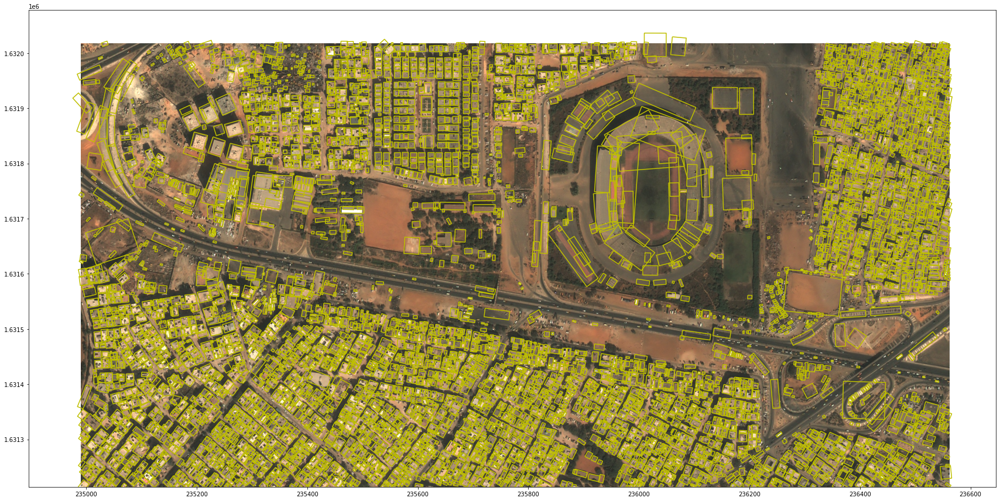

In [76]:
fig, axs = plt.subplots(figsize=(30, 15))
axs.imshow(2.5 * joint_img, extent=extent)
merged.query("pseudo_probability >= 0.2").boundary.plot(ax=axs, color="y")

## 6. Joining Pleiades and SPOT predictions

Join SPOT and Pleiades predictions using the drill-down area. If we ordered Pleiades data only for the drill-down area, we wouldn't get predictions for the entire AOI. 

In [77]:
preds_spot = gpd.read_file(
    filesystem.openbin(
        fs.path.join(spot_inference_config["aws_gpkg_dir"], "predictions_merged_spot.gpkg"),
        "rb",
    ),
    layer="epsg:32628",
)
preds_pleiades = gpd.read_file(
    filesystem.openbin(
        fs.path.join(
            pleiades_inference_config["aws_gpkg_dir"],
            "predictions_merged_pleiades.gpkg",
        ),
        "rb",
    ),
    layer="epsg:32628",
)

In [78]:
bboxes_to_keep = bbox_stats[bbox_stats.drill_index >= DRILL_DOWN_THR]

In [79]:
intersecting = gpd.sjoin(preds_spot, bboxes_to_keep)
preds_spot.drop(index=intersecting.index.values, inplace=True)

In [80]:
intersecting = gpd.sjoin(preds_pleiades, bboxes_to_keep)
new = pd.concat(
    [
        preds_spot,
        intersecting[["eopatch", "pseudo_probability", "CRS_EPSG", "geometry"]].reset_index(drop=True),
    ],
    axis=0,
    ignore_index=True,
)

In [81]:
with LocalFile("predictions_dakar_1p5.gpkg", mode="w", filesystem=None) as f:
    new.drop_duplicates().to_file(f.path, layer="epsg:32628", driver="GPKG")

/home/dperessutti/venvs/qp3/lib/python3.8/site-packages/geopandas/io/file.py:362: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  pd.Int64Index,


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


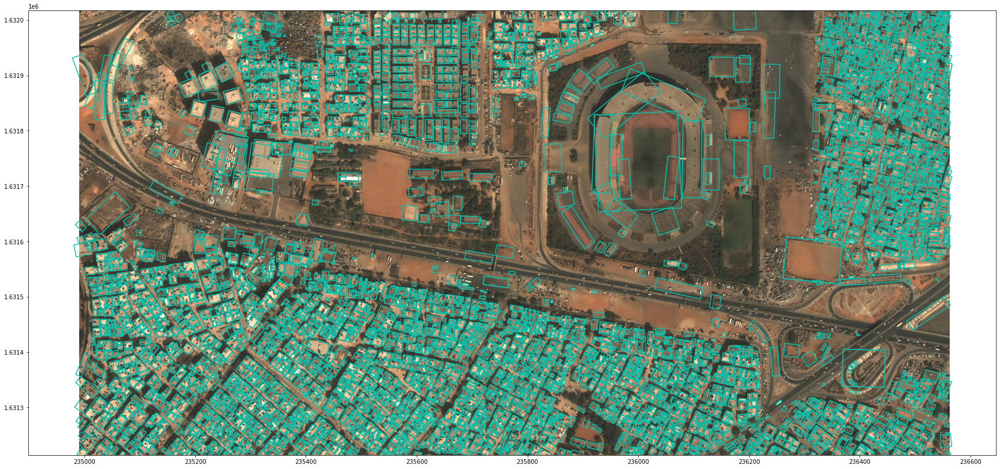

In [82]:
fig, axs = plt.subplots(figsize=(30, 15))
axs.imshow(2.5 * joint_img, extent=extent)
new.query("pseudo_probability >= 0.2").boundary.plot(ax=axs, color="xkcd:turquoise")